## Projeto de Disciplina – Contas de Espécies Ameaçadas

Universidade Federal de São Carlos

Curso: Bacharelado em Ciência da Computação de Sorocaba

Disciplina: Novas Tecnologias de Bancos de Dados

Professora: Profa. Dra. Sahudy Montenegro González

____________________________________________________________
**Grupo 01** 

Integrantes:
- Ana Clara Santana Matta (822396)
- Gabriel Araujo Streicher (822485)


### Objetivo 
Para a elaboração deste projeto, cujo objetivo é construir o protótipo de um Data Warehouse, o tema escolhido foi “Contas de Espécies Ameaçadas”. Ao criar um DW com este tópico, o propósito é analisar dados sobre a fauna e a flora brasileiras em relação ao perigo de extinção; fornecendo uma base consolidada de informações que podem apoiar gestores ambientais e pesquisadores no entendimento da situação ambiental brasileira e apoiar a formulação de políticas de conservação do meio ambiente. 

## 1. Requisitos de Negócio 

- Conhecer o total de espécies ameaçadas por ano;
- Analisar a distribuição de espécies de acordo com o nível de perigo em que elas se encontram;
- Observar a quantidade de espécies ameaçadas de acordo com o seu grupo taxonômico;
- Observar a quantidade de espécies ameaçadas conforme o tipo de ambiente em que vivem;
- Avaliar a quantidade de espécies ameaçadas em cada bioma brasileiro;
- Comparar a situação de risco entre as espécies de diferentes biomas e tipos de ambientes;
- Analisar a evolução do problema ao longo do tempo.


### Fonte dos Dados 

Os dados utilizados foram retirados da API de agregados do IBGE, disponível em: API IBGE. Mais especificamente, o conjunto de dados referente a espécies em extinção, disponíveis na seção de Pesquisa “Contas de Espécies Ameaçadas”. 

A partir dessa fonte, foram selecionadas as seguintes variáveis para compor o Data Warehouse:

- ano;
- quantidade de espécies;
- grupo taxonômico;
- tipo de ambiente;
- bioma;
- categoria de risco. 

A utilização dessas variáveis permite a construção de uma base de dados relevante para o alcance do objetivo deste DW: a análise ambiental. O uso do IBGE como fonte de dados garante confiabilidade, possibilitando que este trabalho sirva como instrumento de apoio à tomada de decisões voltadas à conservação da biodiversidade.


![](imagens/diagrama_fluxo.jpeg)

![](imagens/transformacoes.jpeg)

### 1.1 Consultas 
	
Nesta seção, são apresentadas algumas consultas que podem ser realizadas no Data Warehouse proposto, com o objetivo de validar a cobertura dos requisitos de negócio:

- Quantas espécies classificadas como “Vulnerável” estavam ameaçadas em 2014 em cada bioma? 
- Quantas espécies ameaçadas do grupo taxonômico “Mamíferos” existem em cada tipo de ambiente?
- Quantas espécies ameaçadas estão no bioma “Mata Atlântica” de acordo com as categorias de risco?
- Quantas espécies ameaçadas no bioma “Pantanal” pertencem ao grupo “Flora” agrupadas por ano? 



## 2. Modelagem 

Para este projeto, foi escolhida a utilização do **modelo estrela**, que é amplamente utilizado pela sua facilidade de compreensão e eficiência em consultas. A seguir serão discutidas a formação da tabela fato e das tabelas dimensão.

### 2.1 Tabela Fato

A tabela fato armazena as métricas quantitativas do negócio; no nosso caso a métrica será a **quantidade de espécies**. Sua estrutura pode ser visualizada na Tabela 1. A chave primária desta tabela é formada pelo conjunto de chaves estrangeiras e os valores de ano e bioma. 


![](imagens/tabela_fato.png)

### 2.2 Tabelas Dimensão 

As dimensões armazenam informações sobre os elementos envolvidos nas métricas quantitativas do negócio. Neste DW, utilizamos as dimensões **grupo taxonômico**, **tipo de ambiente** e **categoria de risco**. 
As variáveis **ano** e **bioma** foram incluídas diretamente na Fato por se tratarem de dimensões degeneradas. 

- Dimensão Grupo Taxonômico

![](imagens/tabela_grupo_taxo.png)

A hierarquia taxonômica pode ser melhor visualizada no diagrama abaixo:

![](imagens/hierarquia_grupo_taxo.png)

- Dimensão Ambiente 

![](imagens/tabela_amb.png)

A hierarquia do ambiente pode ser melhor visualizada no diagrama abaixo:

![](imagens/hierarquia_amb.png)

- Dimensão Categoria de Risco 

![](imagens/tabela_categoria_risco.png)

### 2.3 Diagrama do Modelo Estrela 

![](imagens/modelo_estrela.png)

### 2.4 Mapeamento 

Nesta seção, é possível observar a relação entre os atributos presentes no nosso Data Warehouse e sua origem na fonte. As tabelas a seguir apresentam esse mapeamento, incluindo explicações e detalhamentos das transformações realizadas para se obter os valores exatos armazenados nas tabelas do DW.

- Dimensão Grupo Taxonômico 

![](imagens/map_dimGrupoTaxo.png)

- Dimensão Ambiente 

![](imagens/map_dimAmb.png)

- Dimensão Categoria de Risco

![](imagens/map_dimRisco.png)

- Tabela Fato

![](imagens/map_fato.png)

### 2.5 Operações de Limpeza e Transformação 

Além das transformações mencionadas anteriormente — a criação da hierarquia do grupo taxonômico, a definição do tipo aquático em ambiente e a criação de um atributo numérico para a categoria de risco — ainda serão realizadas mais duas operações neste conjunto de dados que servirão para garantir a sua qualidade. 

A primeira delas é a retirada de termos no atributo ‘grupos taxonômicos, hábito ou forma de vida’ que façam distinção entre ambientes aquáticos e terrestres. Isso porque essa informação é redundante em relação ao atributo ‘tipo de ambiente’, que já é responsável por caracterizar o meio em que as espécies se encontram.

A segunda é a substituição dos hífens (‘-’), que indicam ausência de dado na categoria ‘valor’, pelo número 0. Essa operação servirá para padronizar os dados do atributo ‘qtd_especies’ como valores numéricos, permitindo a realização de cálculos e agregações corretas no DW. 


## 3. Implementação 


### Camada Bronze 

Dados Brutos exatamente como recebidos da fonte.

In [0]:
# visualizando a estrutura enviada pelo IBGE 

import json

import requests
import pandas as pd 

url = "https://servicodados.ibge.gov.br/api/v3/agregados/9625/periodos/2014|2022/variaveis/10484?localidades=N1[all]&classificacao=454[48274,48266,59947,59948,48267,48268,48269,48263,48270,48271,48264,48272,48273,59945,59946,48265]|919[48244,48245,48246,48277]|971[59952,59953,59954,59955,59956,59957,59958,59959]|12920[119343,119344,119345,119346,119347,48240,48241,119366]"

# faz uma requisição a essa url do IBGE
try:
    response = requests.get(url)
except HTTPError as e:
    print("HTTP error")
except URLError as e:
    print("Server not found!")

# transforma a resposta em json --> lista de dicionários 
response = response.json()

# a API do IBGE sempre retorna uma lista com apenas 1 elemento
# esse único item é o dicionário com os resultados 
data = response[0]

print(json.dumps(data, indent = 4, ensure_ascii = False))


{
    "id": "10484",
    "variavel": "Número de espécies da fauna e da flora brasileira avaliadas quanto ao risco de extinção",
    "unidade": "Unidades",
    "resultados": [
        {
            "classificacoes": [
                {
                    "id": "454",
                    "nome": "Grupos taxonômicos, hábito ou forma de vida",
                    "categoria": {
                        "48274": "Fauna - vertebrados"
                    }
                },
                {
                    "id": "919",
                    "nome": "Tipo de ambiente",
                    "categoria": {
                        "48244": "Terrestre"
                    }
                },
                {
                    "id": "971",
                    "nome": "Biomas e Sistema Costeiro-Marinho",
                    "categoria": {
                        "59952": "Amazônia"
                    }
                },
                {
                    "id": "12920",
                 

In [0]:
# agr vms fzr a tabela
rows = []

# passando por todos os 'resultados' desse dicionário
for result in data['resultados']:
    #cada resultado é uma combinação de classificação + série

    #a classificação é uma lista com 4 items: grupo taxonômico
    # tipo de ambiente, bioma e categoria de risco
    tax = result['classificacoes'][0]['categoria'].values()
    amb = result['classificacoes'][1]['categoria'].values()
    bioma = result['classificacoes'][2]['categoria'].values()
    risco = result['classificacoes'][3]['categoria'].values()

    # já a série é uma lista que contém 1 item:
    # um dicionário com duas chaves:
    # localidade e ano

    for ano, valor in result['series'][0]['serie'].items():
        rows.append({
            'Ano': ano,
            'Grupo-Taxonomico': list(tax)[0],
            'Tipo-de-Ambiente': list(amb)[0],
            'Bioma': list(bioma)[0],
            'Categoria-de-Risco': list(risco)[0],
            'Quantidade': valor
        })

df = pd.DataFrame(rows)
display(df)

#salvar como delta live table
spark_df = spark.createDataFrame(df)
spark_df.write.format("delta").mode("overwrite").save("/Volumes/workspace/public/volume/delta/camadabronze")

Ano,Grupo-Taxonomico,Tipo-de-Ambiente,Bioma,Categoria-de-Risco,Quantidade
2014,Fauna - vertebrados,Terrestre,Amazônia,Extinta,1
2022,Fauna - vertebrados,Terrestre,Amazônia,Extinta,1
2014,Fauna - vertebrados,Terrestre,Amazônia,Extinta na natureza,-
2022,Fauna - vertebrados,Terrestre,Amazônia,Extinta na natureza,-
2014,Fauna - vertebrados,Terrestre,Amazônia,Criticamente em perigo,12
2022,Fauna - vertebrados,Terrestre,Amazônia,Criticamente em perigo,9
2014,Fauna - vertebrados,Terrestre,Amazônia,Em perigo,31
2022,Fauna - vertebrados,Terrestre,Amazônia,Em perigo,26
2014,Fauna - vertebrados,Terrestre,Amazônia,Vulnerável,90
2022,Fauna - vertebrados,Terrestre,Amazônia,Vulnerável,113


### Camada Prata 

Limpeza e Padronização dos dados provenientes da camada bronze.

In [0]:
# carregando a tabela gerada na camada bronze 
df_spark = spark.read.format("delta").load("/Volumes/workspace/public/volume/delta/camadabronze")
df = df_spark.toPandas()

### Operação 1 

A primeira transformação a ser aplicada ao df é a substituição dos hífens que aparecem na coluna 'Quantidade' quando não existem registros de dados pelo valor 0. Isso serve para manter a consistência do atributo, mantendo-o como valor numérico.

In [0]:
import matplotlib.pyplot as plt
import seaborn as sns

# Contar os hífens 
quantidadeHifens = (df['Quantidade'] == '-').sum()
print(f"Quantidade de valores nulos (hífens): {quantidadeHifens}")

Quantidade de valores nulos (hífens): 5626


In [0]:
# transformando os - na string 0 p eu poder transformar a coluna toda em numeric
df['Quantidade'] = df['Quantidade'].replace('-', '0')
df['Quantidade'] = df['Quantidade'].astype(int)

display(df)

Ano,Grupo-Taxonomico,Tipo-de-Ambiente,Bioma,Categoria-de-Risco,Quantidade
2014,Fauna - vertebrados,Terrestre,Amazônia,Extinta,1
2022,Fauna - vertebrados,Terrestre,Amazônia,Extinta,1
2014,Fauna - vertebrados,Terrestre,Amazônia,Extinta na natureza,0
2022,Fauna - vertebrados,Terrestre,Amazônia,Extinta na natureza,0
2014,Fauna - vertebrados,Terrestre,Amazônia,Criticamente em perigo,12
2022,Fauna - vertebrados,Terrestre,Amazônia,Criticamente em perigo,9
2014,Fauna - vertebrados,Terrestre,Amazônia,Em perigo,31
2022,Fauna - vertebrados,Terrestre,Amazônia,Em perigo,26
2014,Fauna - vertebrados,Terrestre,Amazônia,Vulnerável,90
2022,Fauna - vertebrados,Terrestre,Amazônia,Vulnerável,113


### Operação 2 

A segunda operação consiste na retirada de termos na coluna 'Grupo Taxonômico' que façam distinção entre ambientes aquáticos e terrestres. Isso porque essa informação é redundante em relação ao atributo 'Tipo de Ambiente', que já é responsável por caracterizar o meio em que as espécies se encontram. 

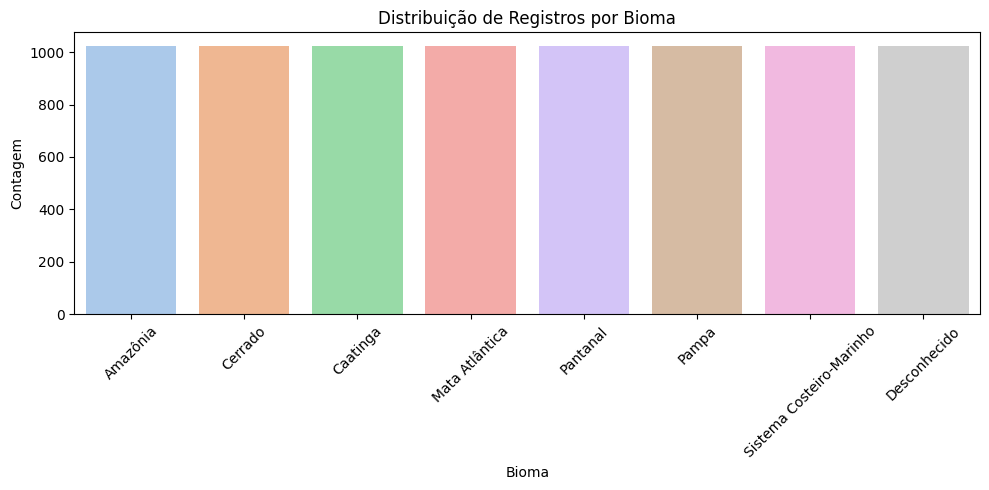

Grupo-Taxonomico
Fauna - vertebrados                                                             512
Fauna - vertebrados - mamíferos                                                 512
Fauna - invertebrados - invertebrados aquáticos - invertebrados marinhos        512
Flora - total                                                                   512
Fauna - invertebrados - invertebrados aquáticos                                 512
Fauna - invertebrados - invertebrados aquáticos - invertebrados de água doce    512
Fauna - invertebrados                                                           512
Fauna - invertebrados - invertebrados terrestres                                512
Fauna - vertebrados - aves                                                      512
Fauna - vertebrados - répteis                                                   512
Fauna - vertebrados - anfíbios                                                  512
Fauna - vertebrados - peixes                               

In [0]:
plt.figure(figsize=(10, 5))

sns.countplot(
    data=df, 
    x='Bioma', 
    palette='pastel',
    hue='Bioma'
)

plt.title('Distribuição de Registros por Bioma')
plt.xlabel('Bioma')
plt.ylabel('Contagem')
plt.xticks(rotation=45) 

plt.tight_layout()
plt.show()

df['Grupo-Taxonomico'].value_counts()


In [0]:
df['Tipo-de-Ambiente'].value_counts()


Tipo-de-Ambiente
Terrestre       2048
Água doce       2048
Marinho         2048
Desconhecido    2048
Name: count, dtype: int64

In [0]:
df['Categoria-de-Risco'].value_counts()

Categoria-de-Risco
Extinta                   1024
Extinta na natureza       1024
Criticamente em perigo    1024
Em perigo                 1024
Vulnerável                1024
Quase ameaçada            1024
Menos preocupante         1024
Dados insuficientes       1024
Name: count, dtype: int64

In [0]:
novo_grupoTax = []

for grupo in df['Grupo-Taxonomico']:
    # dividindo a string em uma lista
    p = grupo.split(' - ')

    if p[0] == 'Flora':
        novo_grupoTax.append('Flora')
        continue

    if len(p) >= 3 and p[1] == 'invertebrados':
        novo_grupoTax.append(' - '.join(p[:2]))
        continue

    # se tiver pelo menos 4 partes cria uma nova string com só as 3 primeiras
    if len(p) >= 4:
        novo_grupoTax.append(' - '.join(p[:3]))
    else:
        novo_grupoTax.append(' - '.join(p))

# substitui a coluna antiga
df['Grupo-Taxonomico'] = novo_grupoTax

display(df)

Ano,Grupo-Taxonomico,Tipo-de-Ambiente,Bioma,Categoria-de-Risco,Quantidade
2014,Fauna - vertebrados,Terrestre,Amazônia,Extinta,1
2022,Fauna - vertebrados,Terrestre,Amazônia,Extinta,1
2014,Fauna - vertebrados,Terrestre,Amazônia,Extinta na natureza,0
2022,Fauna - vertebrados,Terrestre,Amazônia,Extinta na natureza,0
2014,Fauna - vertebrados,Terrestre,Amazônia,Criticamente em perigo,12
2022,Fauna - vertebrados,Terrestre,Amazônia,Criticamente em perigo,9
2014,Fauna - vertebrados,Terrestre,Amazônia,Em perigo,31
2022,Fauna - vertebrados,Terrestre,Amazônia,Em perigo,26
2014,Fauna - vertebrados,Terrestre,Amazônia,Vulnerável,90
2022,Fauna - vertebrados,Terrestre,Amazônia,Vulnerável,113


### Operação 3 

A terceira transformação a ser realizada é a criação de uma nova coluna que associa cada Categoria de Risco a um valor numérico a fim de facilitar consultas futuras. 

In [0]:
mapeamento_num_risco = {
    'Extinta': 1,
    'Extinta na natureza': 2,
    'Criticamente em perigo': 3,
    'Em perigo': 4,
    'Quase ameaçada': 5,
    'Vulnerável': 6,
    'Menos preocupante': 7
}

df['Nivel-de-Risco'] = df['Categoria-de-Risco'].map(mapeamento_num_risco)

display(df)


Ano,Grupo-Taxonomico,Tipo-de-Ambiente,Bioma,Categoria-de-Risco,Quantidade,Nivel-de-Risco
2014,Fauna - vertebrados,Terrestre,Amazônia,Extinta,1,1.0
2022,Fauna - vertebrados,Terrestre,Amazônia,Extinta,1,1.0
2014,Fauna - vertebrados,Terrestre,Amazônia,Extinta na natureza,0,2.0
2022,Fauna - vertebrados,Terrestre,Amazônia,Extinta na natureza,0,2.0
2014,Fauna - vertebrados,Terrestre,Amazônia,Criticamente em perigo,12,3.0
2022,Fauna - vertebrados,Terrestre,Amazônia,Criticamente em perigo,9,3.0
2014,Fauna - vertebrados,Terrestre,Amazônia,Em perigo,31,4.0
2022,Fauna - vertebrados,Terrestre,Amazônia,Em perigo,26,4.0
2014,Fauna - vertebrados,Terrestre,Amazônia,Vulnerável,90,6.0
2022,Fauna - vertebrados,Terrestre,Amazônia,Vulnerável,113,6.0


### Operação 4

A quarta transformação a ser realizada é a criação da hierarquia do Grupo Taxonômico. O valor será quebrado em 3 colunas distintas: Reino, Subgrupo e Classe. 



In [0]:
from pyspark.sql.functions import monotonically_increasing_id, split, col, when, element_at, size

split_data = df['Grupo-Taxonomico'].str.split(' - ', expand=True)
df['Reino'] = split_data[0]
df['Subgrupo'] = split_data[1] if 1 in split_data.columns else None
df['Classe'] = split_data[2] if 2 in split_data.columns else None

df.drop(columns=['Grupo-Taxonomico'], inplace=True)

display(df)

Ano,Tipo-de-Ambiente,Bioma,Categoria-de-Risco,Quantidade,Nivel-de-Risco,Reino,Subgrupo,Classe
2014,Terrestre,Amazônia,Extinta,1,1.0,Fauna,vertebrados,null
2022,Terrestre,Amazônia,Extinta,1,1.0,Fauna,vertebrados,null
2014,Terrestre,Amazônia,Extinta na natureza,0,2.0,Fauna,vertebrados,null
2022,Terrestre,Amazônia,Extinta na natureza,0,2.0,Fauna,vertebrados,null
2014,Terrestre,Amazônia,Criticamente em perigo,12,3.0,Fauna,vertebrados,null
2022,Terrestre,Amazônia,Criticamente em perigo,9,3.0,Fauna,vertebrados,null
2014,Terrestre,Amazônia,Em perigo,31,4.0,Fauna,vertebrados,null
2022,Terrestre,Amazônia,Em perigo,26,4.0,Fauna,vertebrados,null
2014,Terrestre,Amazônia,Vulnerável,90,6.0,Fauna,vertebrados,null
2022,Terrestre,Amazônia,Vulnerável,113,6.0,Fauna,vertebrados,null


### Operação 5

A quinta transformação a ser realizada é a criação da hierarquia no tipo de ambiente.

In [0]:
map_tipo = {
    'Terrestre': 'Terrestre',
    'Água doce': 'Aquatico',
    'Marinho': 'Aquatico',
    'Desconhecido': 'Desconhecido'
}

map_subtipo = {
    'Água doce': 'Água doce',
    'Marinho': 'Marinho'
}

df['Tipo-Ambiente'] = df['Tipo-de-Ambiente'].map(map_tipo)
df['Subtipo-Ambiente'] = df['Tipo-de-Ambiente'].map(map_subtipo)

df.drop(columns=['Tipo-de-Ambiente'], inplace=True)

display(df)

Ano,Bioma,Categoria-de-Risco,Quantidade,Nivel-de-Risco,Reino,Subgrupo,Classe,Tipo-Ambiente,Subtipo-Ambiente
2014,Amazônia,Extinta,1,1.0,Fauna,vertebrados,null,Terrestre,null
2022,Amazônia,Extinta,1,1.0,Fauna,vertebrados,null,Terrestre,null
2014,Amazônia,Extinta na natureza,0,2.0,Fauna,vertebrados,null,Terrestre,null
2022,Amazônia,Extinta na natureza,0,2.0,Fauna,vertebrados,null,Terrestre,null
2014,Amazônia,Criticamente em perigo,12,3.0,Fauna,vertebrados,null,Terrestre,null
2022,Amazônia,Criticamente em perigo,9,3.0,Fauna,vertebrados,null,Terrestre,null
2014,Amazônia,Em perigo,31,4.0,Fauna,vertebrados,null,Terrestre,null
2022,Amazônia,Em perigo,26,4.0,Fauna,vertebrados,null,Terrestre,null
2014,Amazônia,Vulnerável,90,6.0,Fauna,vertebrados,null,Terrestre,null
2022,Amazônia,Vulnerável,113,6.0,Fauna,vertebrados,null,Terrestre,null


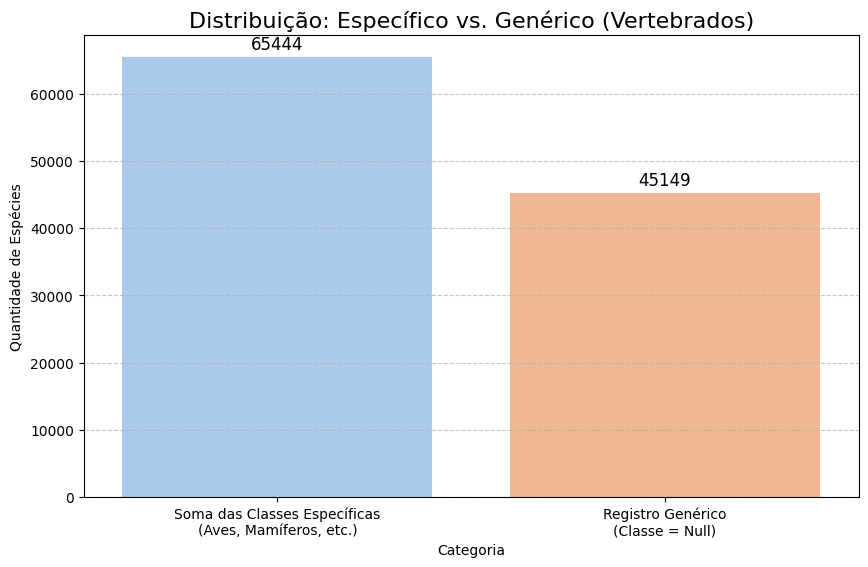

In [0]:
df_vert = df[df['Subgrupo'] == 'vertebrados']

df_generico = df_vert[df_vert['Classe'].isnull()]
df_especifico = df_vert[df_vert['Classe'].notnull()]


soma_generico = df_generico['Quantidade'].sum()
soma_especifico = df_especifico['Quantidade'].sum()

df_compare = pd.DataFrame({
    'Categoria': ['Soma das Classes Específicas\n(Aves, Mamíferos, etc.)', 'Registro Genérico\n(Classe = Null)'],
    'Quantidade Total': [soma_especifico, soma_generico]
})


plt.figure(figsize=(10, 6))
ax = sns.barplot(x='Categoria', y='Quantidade Total', data=df_compare, palette='pastel', hue='Categoria')


for i in ax.containers:
    ax.bar_label(i, fmt='%.0f', fontsize=12, padding=3)

plt.title('Distribuição: Específico vs. Genérico (Vertebrados)', fontsize=16)
plt.ylabel('Quantidade de Espécies')
plt.grid(axis='y', linestyle='--', alpha=0.7)

In [0]:
# salvando a tabela prata
spark_df = spark.createDataFrame(df)
spark_df.write.format("delta").mode("overwrite").save("/Volumes/workspace/public/volume/delta/camadaprata")

### Camada Ouro 

Etapa final em que os dados padronizados da camada prata são estruturados para análise. É onde ocorre a criação das dimensões e da tabela fato do DW. 

In [0]:
# carregando a tabela gerada na camada prata
prata = spark.read.format("delta").load("/Volumes/workspace/public/volume/delta/camadaprata")

prata.createOrReplaceTempView("silver")

### Dimensão Grupo Taxonômico 

Nesta dimensão estão armazenadas as informações provenientes do atributo "Grupo-Taxonômico" da tabela original. Esse campo trazia várias classificações em uma única linha, separadas por hífens.

Para que esses dados pudessem ser utilizados de maneira analítica, a Dimensão Grupo Taxonômico foi estruturada em uma hierarquia de três níveis, conforme o esquema abaixo: 

In [0]:
from pyspark.sql.functions import monotonically_increasing_id, split, col, when, element_at, size

df_grupo_taxonomico = spark.table("silver").select("Reino", "Subgrupo", "Classe").distinct() \
    .withColumn('grupo_taxonomico_id',  monotonically_increasing_id())


df_grupo_taxonomico.write.format("delta").mode("overwrite").save('/Volumes/workspace/public/volume/delta/dim-grupo-taxonomico')
display(df_grupo_taxonomico)

Reino,Subgrupo,Classe,grupo_taxonomico_id
Fauna,vertebrados,null,0
Fauna,vertebrados,mamíferos,1
Fauna,invertebrados,null,2
Flora,null,null,3
Fauna,vertebrados,répteis,4
Fauna,vertebrados,aves,5
Fauna,vertebrados,anfíbios,6
Fauna,vertebrados,peixes,7


### Dimensão Categoria de Risco 

Essa dimensão armazena os dados provenientes do atributo 'Categoria-de-Risco' da tabela original e do atributo 'Nível-de-Risco' que foi gerado na camada prata. Esses campos indicam o grau de ameaça associado a cada organismo, de forma textual e numérica. 

In [0]:
df_risco = spark.table("silver").select("Categoria-de-Risco", "Nivel-de-Risco").distinct() \
    .withColumn('categoria_risco_id', monotonically_increasing_id())

df_risco = df_risco.withColumnRenamed("Categoria-de-Risco", "categoria")
df_risco = df_risco.withColumnRenamed("Nivel-de-Risco", "categoria_num")

df_risco.write.format("delta").mode("overwrite").save('/Volumes/workspace/public/volume/delta/dim-categoria-risco')
display(df_risco)

categoria,categoria_num,categoria_risco_id
Menos preocupante,7.0,0
Vulnerável,6.0,1
Em perigo,4.0,2
Quase ameaçada,5.0,3
Criticamente em perigo,3.0,4
Extinta,1.0,5
Dados insuficientes,null,6
Extinta na natureza,2.0,7


### Dimensão Ambiente 

A Dimensão Ambiente armazena as informações provenientes do atributo 'Tipo-de-Ambiente' da tabela original. Esse dado apresentava uma diferença nas categorias de habitat, sendo algumas mais específicas e outras mais gerais. Por esse motivo, a dimensão também foi dividida em níveis hierárquicos. 

In [0]:
df_ambiente = spark.table("silver").select("Tipo-Ambiente", "Subtipo-Ambiente").distinct() \
    .withColumn('ambiente_id', monotonically_increasing_id())



df_ambiente.write.format("delta").mode("overwrite").save('/Volumes/workspace/public/volume/delta/dim-ambiente')
display(df_ambiente)

Tipo-Ambiente,Subtipo-Ambiente,ambiente_id
Desconhecido,null,0
Aquatico,Marinho,1
Terrestre,null,2
Aquatico,Água doce,3


### Tabela Fato 

A tabela Fato representa o centro do modelo dimensional. Ela armazena os valores numéricos que serão analisados e conecta esses dados às respectivas dimensões. 

Nesta etapa, realizamos junções entre o dataframe temporário criado anteriormente e as dimensões do DW. Como resultado, a tabela fato contém as chaves para as dimensões, assim como a métrica utilizada nas análises que é a quantidade de espécies em risco. 

Os atributos 'Bioma' e 'Ano' também estão inclusos na fato, pois se comportam como dimensões degeneradas no modelo original. 

In [0]:
df_temp = spark.read.format("delta").load('/Volumes/workspace/public/volume/delta/camadaprata')
df_grupo = spark.read.format("delta").load('/Volumes/workspace/public/volume/delta/dim-grupo-taxonomico')
df_risco = spark.read.format("delta").load('/Volumes/workspace/public/volume/delta/dim-categoria-risco')
df_ambiente = spark.read.format("delta").load('/Volumes/workspace/public/volume/delta/dim-ambiente')

df_fato = (
    df_temp
    .join(
        df_grupo,
        (
            df_temp.Reino.eqNullSafe(df_grupo.Reino) &
            df_temp.Subgrupo.eqNullSafe(df_grupo.Subgrupo) &
            df_temp.Classe.eqNullSafe(df_grupo.Classe)
        ),
        'left'
    )

    .join(
        df_risco,
        (
            df_temp['Categoria-de-Risco'].eqNullSafe(df_risco['categoria']) &
            df_temp['Nivel-de-Risco'].eqNullSafe(df_risco['categoria_num'])
        ),
        'left'
    )

    .join(
        df_ambiente,
        (
            df_temp['Tipo-Ambiente'].eqNullSafe(df_ambiente['Tipo-Ambiente']) &
            df_temp['Subtipo-Ambiente'].eqNullSafe(df_ambiente['Subtipo-Ambiente'])
        ),
        'left'
    )

    .select(
        "grupo_taxonomico_id",
        "categoria_risco_id",
        "ambiente_id",
        df_temp["Ano"].alias("ano"),
        df_temp["Bioma"].alias("bioma"),
        df_temp["Quantidade"].alias("quantidade")
    )
)

display(df_fato)
df_fato.write.format('delta').mode('overwrite').save('/Volumes/workspace/public/volume/delta/fato')

grupo_taxonomico_id,categoria_risco_id,ambiente_id,ano,bioma,quantidade
0,5,2,2014,Amazônia,1
0,5,2,2022,Amazônia,1
0,7,2,2014,Amazônia,0
0,7,2,2022,Amazônia,0
0,4,2,2014,Amazônia,12
0,4,2,2022,Amazônia,9
0,2,2,2014,Amazônia,31
0,2,2,2022,Amazônia,26
0,1,2,2014,Amazônia,90
0,1,2,2022,Amazônia,113


### Consultas 

Nesta seção, vamos realizar algumas consultas para validar a cobertura dos requisitos de negócio agora que o DW foi concluído.

In [0]:
# carregando as tabelas geradas na camada ouro
fato = spark.read.format("delta").load("/Volumes/workspace/public/volume/delta/fato")
fato.createOrReplaceTempView("fato")

dim_grupo = spark.read.format("delta").load('/Volumes/workspace/public/volume/delta/dim-grupo-taxonomico')
dim_grupo.createOrReplaceTempView("dim_grupo")

dim_risco = spark.read.format("delta").load('/Volumes/workspace/public/volume/delta/dim-categoria-risco')
dim_risco.createOrReplaceTempView("dim_risco")

dim_ambiente = spark.read.format("delta").load('/Volumes/workspace/public/volume/delta/dim-ambiente')
dim_ambiente.createOrReplaceTempView("dim_ambiente")


### Consulta 1 

Quantas espécies classificadas como “Vulnerável” estavam ameaçadas em 2014 em cada bioma? 

In [0]:
df_cons1 = spark.sql("""
  SELECT fato.bioma, SUM(quantidade) AS qtd FROM fato 
  JOIN dim_risco ON dim_risco.categoria_risco_id = fato.categoria_risco_id 
  WHERE dim_risco.categoria_num = 6 AND fato.ano = 2014
  GROUP BY (fato.bioma);
  """)

display(df_cons1)

bioma,qtd
Caatinga,298
Amazônia,429
Pampa,204
Cerrado,680
Sistema Costeiro-Marinho,266
Pantanal,112
Desconhecido,3
Mata Atlântica,1152


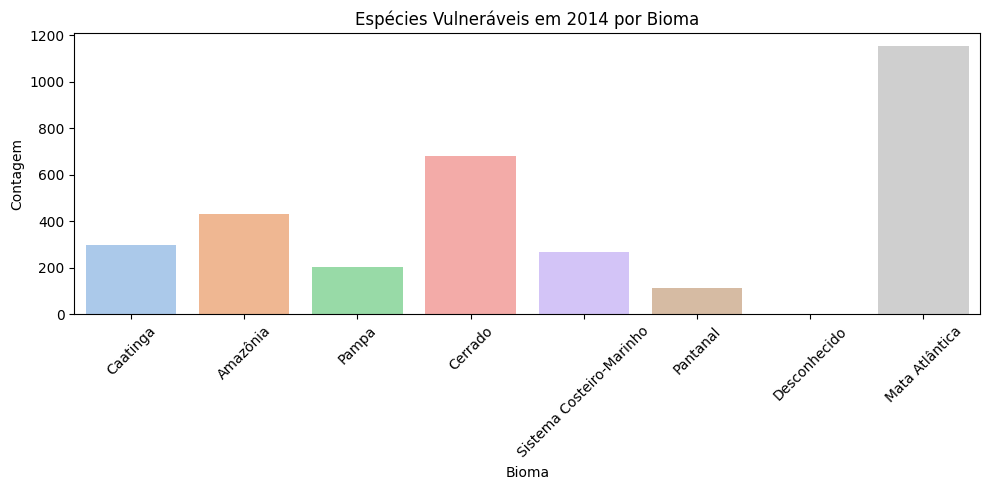

In [0]:
plt.figure(figsize=(10, 5))

sns.barplot(
    data=df_cons1.toPandas(), 
    x='bioma', 
    y='qtd',
    palette='pastel',
    hue='bioma'
)

plt.title('Espécies Vulneráveis em 2014 por Bioma')
plt.xlabel('Bioma')
plt.ylabel('Contagem')
plt.xticks(rotation=45) 

plt.tight_layout()
plt.show()

- Análise:

O resultado da consulta nos mostra que, em 2014, o bioma Mata Atlântica apresentou um número preocupantemente elevado de espécies ameaçadas. Foram 1.152 espécies, um valor muito superior ao do segundo bioma mais crítico, o Cerrado, com 680 e ao do terceiro bioma mais crítico, a Amazônia, com 429. 
Esse contraste evidencia que as espécies que vivem na Mata Atlântica devem ser tratadas com prioridade na luta pela preservação das espécies. 


### Consulta 2 

Quantas espécies ameaçadas do grupo taxonômico “Mamíferos” existem em cada tipo de ambiente?

In [0]:
df_cons2 = spark.sql("""
  SELECT dim_ambiente.`Tipo-Ambiente`, SUM(quantidade) AS qtd FROM fato 
  JOIN dim_ambiente ON dim_ambiente.ambiente_id = fato.ambiente_id
  JOIN dim_grupo ON dim_grupo.grupo_taxonomico_id = fato.grupo_taxonomico_id
  WHERE dim_grupo.Classe = 'mamíferos' 
  GROUP BY(`Tipo-Ambiente`);
  """)

display(df_cons2)

Tipo-Ambiente,qtd
Aquatico,712
Desconhecido,0
Terrestre,6508


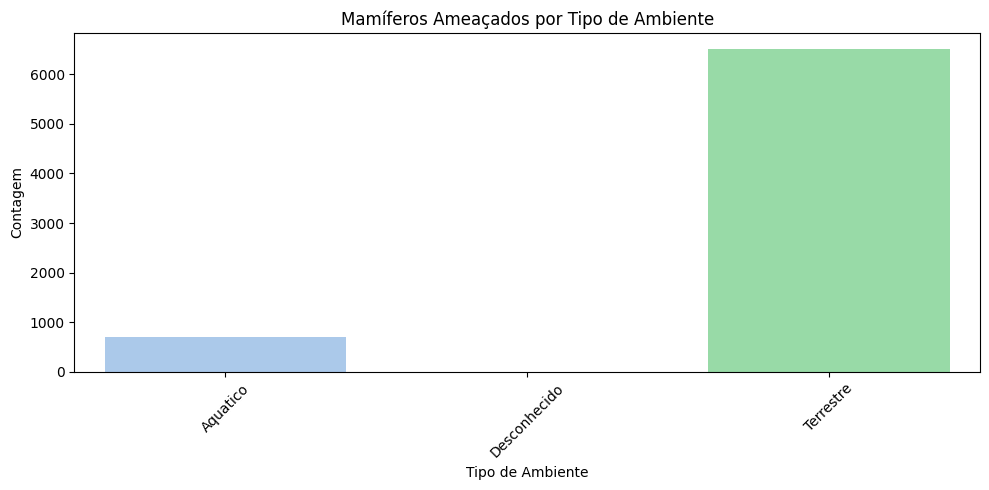

In [0]:
plt.figure(figsize=(10, 5))

sns.barplot(
    data=df_cons2.toPandas(), 
    x='Tipo-Ambiente', 
    y='qtd',
    palette='pastel',
    hue='Tipo-Ambiente'
)

plt.title('Mamíferos Ameaçados por Tipo de Ambiente')
plt.xlabel('Tipo de Ambiente')
plt.ylabel('Contagem')
plt.xticks(rotation=45) 

plt.tight_layout()
plt.show()

- Análise:

Nessa consulta, analisamos a quantidade de mamíferos ameaçados de acordo com o tipo de ambiente em que vivem. O gráfico mostra que o ambiente terrestre concentra um número muito maior de espécies em perigo, totalizando 6.508, enquanto o ambiente aquático apresenta 702 espécies ameaçadas.
Isso indica que, no contexto da conservação de mamíferos, a proteção dos ambientes terrestres deve ser tratada como prioridade, pois é neles que se concentra a maior parte das espécies em perigo. 


### Consulta 3 

Quantas espécies ameaçadas estão no bioma “Mata Atlântica” de acordo com as categorias de risco?

In [0]:
df_cons3 = spark.sql("""
    SELECT dim_risco.categoria, SUM(quantidade) AS qtd FROM fato 
    JOIN dim_risco ON dim_risco.categoria_risco_id = fato.categoria_risco_id 
    WHERE fato.bioma = 'Mata Atlântica' 
    GROUP BY(dim_risco.categoria);
  """)

display(df_cons3)

categoria,qtd
Vulnerável,2431
Extinta na natureza,4
Quase ameaçada,1841
Em perigo,3696
Extinta,36
Criticamente em perigo,1967
Dados insuficientes,5171
Menos preocupante,34316


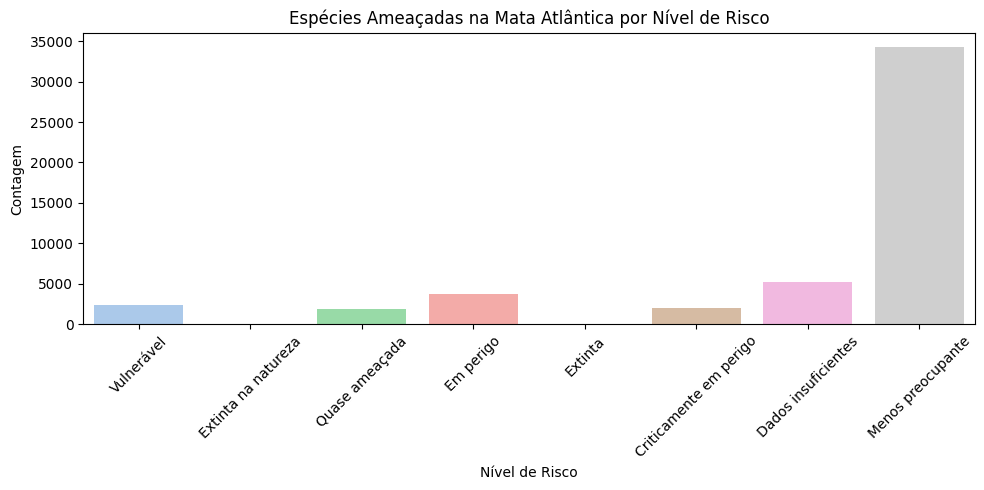

In [0]:
plt.figure(figsize=(10, 5))

sns.barplot(
    data=df_cons3.toPandas(), 
    x='categoria', 
    y='qtd',
    palette='pastel',
    hue='categoria'
)

plt.title('Espécies Ameaçadas na Mata Atlântica por Nível de Risco')
plt.xlabel('Nível de Risco')
plt.ylabel('Contagem')
plt.xticks(rotation=45) 

plt.tight_layout()
plt.show()

- Análise:

Como visto na consulta 1, a Mata Atlântica é um dos biomas com maior número de espécies ameaçadas. Esta consulta analisa como esses riscos se distribuem entre os diferentes níveis de perigo. O resultado mostra que a maior parte das espécies está classificada em uma categoria de ameaça menos preocupante, totalizando 34.316 espécies. Já as categorias mais graves, como Em Perigo e Criticamente em Perigo, apresentam valores bem menores, 3.696 e 1.967, respectivamente.
Isso indica que, embora a Mata Atlântica apresente um grande número de espécies ameaçadas, essa quantidade pode estar relacionada à alta diversidade do bioma. Ou seja, por possuir uma grande variedade de espécies, ele tende a aparecer nas primeiras posições do “ranking de perigo”, mesmo que muitas dessas espécies não estejam exatamente em situação de risco.

**obs:** a Mata Atlântica é o bioma com a maior diversidade de espécies no Brasil. 

### Consulta 4 

Quantas espécies ameaçadas no bioma “Pantanal” pertencem ao grupo “Flora” agrupadas por ano? 

In [0]:
df_cons4 = spark.sql("""
    SELECT fato.ano, SUM(quantidade) AS qtd FROM fato
    JOIN dim_grupo ON dim_grupo.grupo_taxonomico_id = fato.grupo_taxonomico_id
    WHERE dim_grupo.Reino = 'Flora' AND fato.bioma = 'Pantanal'
    GROUP BY(fato.ano);        
  """)

display(df_cons4)

ano,qtd
2014,240
2022,274


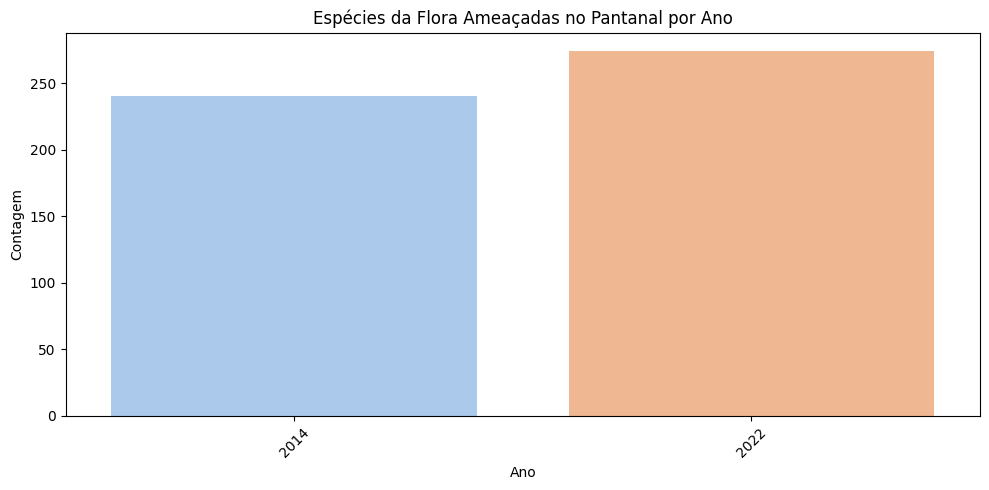

In [0]:
plt.figure(figsize=(10, 5))

sns.barplot(
    data=df_cons4.toPandas(), 
    x='ano', 
    y='qtd',
    palette='pastel',
    hue='ano'
)

plt.title('Espécies da Flora Ameaçadas no Pantanal por Ano')
plt.xlabel('Ano')
plt.ylabel('Contagem')
plt.xticks(rotation=45) 

plt.tight_layout()
plt.show()

- Análise:

A última consulta analisa a evolução da situação de risco da Flora nativa do Pantanal ao longo do tempo. O gráfico mostra que, em 2014, o primeiro ano de observação, havia 240 espécies ameaçadas. Em 2022, esse valor subiu para 274. 
Ocorreu um aumento de 34 espécies em 8 anos. 
Isso indica que o problema se agravou com o tempo, porém de forma razoavelmente lenta. A variação é bem pequena se comparada com o intervalo de tempo. Assim, embora essa evolução não deva ser ignorada, a flora do Pantanal não se enquadra como uma situação de perigo prioritária, considerando o cenário brasileiro. 

## Conclusão

A realização deste projeto permitiu colocar em prática os conceitos aprendidos ao longo da disciplina. A partir dele, adquirimos experiência na construção e na utilização de Data Warehouses, compreendendo melhor seu fluxo, organização e funcionamento.  

A implementação caminhou bem, com desafios que foram superados pontualmente. A simplicidade de utilização da API do IBGE e os dados já muito bem organizados e agregados foram de extrema ajuda. 

O DW desenvolvido neste notebook atende a todos os requisitos de negócio definidos no início do documento e, por isso, acreditamos que ele está apto a cumprir  seu objetivo: apoiar gestores e pesquisadores ambientais na tomada de decisões relacionadas à preservação da biodiversidade. 




## Contribuições dos Integrantes

- **Ana Clara:** Extração, consultas, requisitos de negócios, transformações (1-3) e conclusão.
- **Gabriel:** Transformações (4-5), EDA, modelagem do DW e diagramas.

## Apêndice - Esquema do DW

O schema desse Data Warehouse foi colocado em uma pasta do Drive. [Clique aqui](https://drive.google.com/drive/folders/1NGowRCOJf3PCXyZM2hzjDzRxhNWBdzDB?usp=sharing) para acessar. 